Install the Kaggle Package to import data

In [0]:
!pip install -U -q kaggle
!mkdir -p ~/.kaggle

In [3]:
#Download kaggle.json from Kaggle
#Import json into notebook 
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"khairul5831","key":"7ddcf96cfe4ac5904526619a39595152"}'}

In [10]:
#authenticate json content
!cp kaggle.json ~/.kaggle/
!ls -l ~/.kaggle
!cat ~/.kaggle/kaggle.json

total 4
-rw-r--r-- 1 root root 67 May 21 08:21 kaggle.json
{"username":"khairul5831","key":"7ddcf96cfe4ac5904526619a39595152"}

In [8]:
#Install kaggle packages
!pip install -q kaggle
!pip install -q kaggle-cli

     |████████████████████████████████| 81kB 3.7MB/s 
     |████████████████████████████████| 5.3MB 9.2MB/s 
     |████████████████████████████████| 112kB 45.4MB/s 
     |████████████████████████████████| 51kB 18.2MB/s 
     |████████████████████████████████| 102kB 26.5MB/s 


To check if the connection to Kaggle is successful

In [9]:
#List Kaggle DataSets
!kaggle datasets list

ref                                                          title                                                size  lastUpdated          downloadCount  
-----------------------------------------------------------  --------------------------------------------------  -----  -------------------  -------------  
ronitf/heart-disease-uci                                     Heart Disease UCI                                     3KB  2018-06-25 11:33:56          50947  
noriuk/us-education-datasets-unification-project             U.S. Education Datasets: Unification Project         85MB  2019-03-02 18:41:52           5345  
iarunava/cell-images-for-detecting-malaria                   Malaria Cell Images Dataset                         337MB  2018-12-05 05:40:21           7493  
karangadiya/fifa19                                           FIFA 19 complete player dataset                       2MB  2018-12-21 03:52:59          32971  
bigquery/crypto-ethereum-classic                          

In [0]:
#List Kaggle Competitions
!kaggle competitions list

ref                                                deadline             category            reward  teamCount  userHasEntered  
-------------------------------------------------  -------------------  ---------------  ---------  ---------  --------------  
digit-recognizer                                   2030-01-01 00:00:00  Getting Started  Knowledge       3015           False  
titanic                                            2030-01-01 00:00:00  Getting Started  Knowledge      11216           False  
house-prices-advanced-regression-techniques        2030-01-01 00:00:00  Getting Started  Knowledge       4628           False  
imagenet-object-localization-challenge             2029-12-31 07:00:00  Research         Knowledge         37           False  
competitive-data-science-predict-future-sales      2019-12-31 23:59:00  Playground           Kudos       3178           False  
recognizing-faces-in-the-wild                      2019-08-01 23:59:00  Playground       Knowledge      

In [0]:
#list files in a dataset /competition using string pattern
#!kaggle datasets list -d simjeg/lymphoma-subtype-classification-fl-vs-clls

In [0]:
!kaggle datasets download -d paultimothymooney/breast-histopathology-images

100% 1.48G/1.49G [00:29<00:00, 37.2MB/s]
100% 1.49G/1.49G [00:29<00:00, 54.6MB/s]


In [0]:
#unzipfile
#!unzip breast-histopathology-images


Archive:  breast-histopathology-images.zip
  inflating: IDC_regular_ps50_idx5.zip  


In [0]:
!unzip IDC_regular_ps50_idx5.zip -d BreastCancer

Archive:  IDC_regular_ps50_idx5.zip
   creating: BreastCancer/10253/
   creating: BreastCancer/10253/0/
 extracting: BreastCancer/10253/0/10253_idx5_x1001_y1001_class0.png  
 extracting: BreastCancer/10253/0/10253_idx5_x1001_y1051_class0.png  
 extracting: BreastCancer/10253/0/10253_idx5_x1001_y1101_class0.png  
 extracting: BreastCancer/10253/0/10253_idx5_x1001_y1151_class0.png  
 extracting: BreastCancer/10253/0/10253_idx5_x1001_y1201_class0.png  
 extracting: BreastCancer/10253/0/10253_idx5_x1001_y1251_class0.png  
 extracting: BreastCancer/10253/0/10253_idx5_x1001_y1301_class0.png  
 extracting: BreastCancer/10253/0/10253_idx5_x1001_y1351_class0.png  
 extracting: BreastCancer/10253/0/10253_idx5_x1001_y1501_class0.png  
 extracting: BreastCancer/10253/0/10253_idx5_x1001_y1551_class0.png  
 extracting: BreastCancer/10253/0/10253_idx5_x1001_y1701_class0.png  
 extracting: BreastCancer/10253/0/10253_idx5_x1001_y351_class0.png  
 extracting: BreastCancer/10253/0/10253_idx5_x1001_y401_c

In [0]:
import pandas as pd
import numpy as np
import os
from glob import glob
import itertools
import fnmatch
import random
import matplotlib.pylab as plt
import seaborn as sns
import cv2
from scipy.misc import imresize, imread
import sklearn
from sklearn import model_selection
from sklearn.model_selection import train_test_split, KFold, cross_val_score, StratifiedKFold, learning_curve, GridSearchCV
from sklearn.metrics import confusion_matrix, make_scorer, accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC, LinearSVC
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
import keras
from keras import backend as K
from keras.callbacks import Callback, EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
from keras.preprocessing.image import ImageDataGenerator
from keras.utils.np_utils import to_categorical
from keras.models import Sequential, model_from_json
from keras.optimizers import SGD, RMSprop, Adam, Adagrad, Adadelta
from keras.layers import Dense, Dropout, Activation, Flatten, BatchNormalization, Conv2D, MaxPool2D, MaxPooling2D
%matplotlib inline

Using TensorFlow backend.


In [0]:
imagePatches = glob('/content/BreastCancer/**/*.png', recursive=True)
for filename in imagePatches[0:10]:
    print(filename)

/content/BreastCancer/9322/1/9322_idx5_x2951_y1501_class1.png
/content/BreastCancer/9322/1/9322_idx5_x2801_y1401_class1.png
/content/BreastCancer/9322/1/9322_idx5_x2151_y1451_class1.png
/content/BreastCancer/9322/1/9322_idx5_x2101_y1851_class1.png
/content/BreastCancer/9322/1/9322_idx5_x2801_y1151_class1.png
/content/BreastCancer/9322/1/9322_idx5_x2951_y1151_class1.png
/content/BreastCancer/9322/1/9322_idx5_x2151_y1401_class1.png
/content/BreastCancer/9322/1/9322_idx5_x2551_y1301_class1.png
/content/BreastCancer/9322/1/9322_idx5_x2851_y1351_class1.png
/content/BreastCancer/9322/1/9322_idx5_x3001_y1351_class1.png


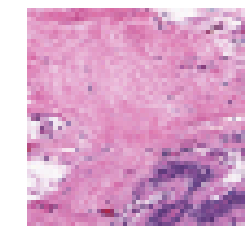

In [0]:
image_name = "/content/BreastCancer/10253/0/10253_idx5_x1001_y1001_class0.png" #Image to be used as query
def plotImage(image_location):
    image = cv2.imread(image_name)
    image = cv2.resize(image, (50,50))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)); plt.axis('off')
    return
plotImage(image_name)

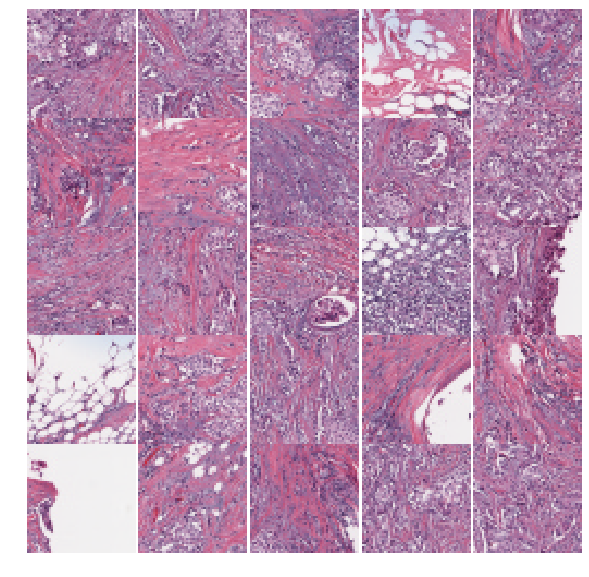

In [0]:
# Plot Multiple Images
bunchOfImages = imagePatches
i_ = 0
plt.rcParams['figure.figsize'] = (10.0, 10.0)
plt.subplots_adjust(wspace=0, hspace=0)
for l in bunchOfImages[:25]:
    im = cv2.imread(l)
    im = cv2.resize(im, (50, 50)) 
    plt.subplot(5, 5, i_+1) #.set_title(l)
    plt.imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB)); plt.axis('off')
    i_ += 1

Step 3: Preprocess Data

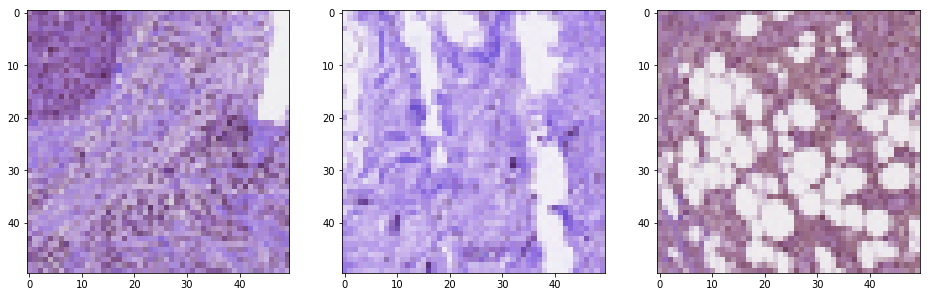

In [0]:
def randomImages(a):
    r = random.sample(a, 4)
    plt.figure(figsize=(16,16))
    plt.subplot(131)
    plt.imshow(cv2.imread(r[0]))
    plt.subplot(132)
    plt.imshow(cv2.imread(r[1]))
    plt.subplot(133)
    plt.imshow(cv2.imread(r[2])); 
randomImages(imagePatches)

In [0]:
patternZero = '*class0.png'
patternOne = '*class1.png'
classZero = fnmatch.filter(imagePatches, patternZero)
classOne = fnmatch.filter(imagePatches, patternOne)
print("IDC(-)\n\n",classZero[0:5],'\n')
print("IDC(+)\n\n",classOne[0:5])

IDC(-)

 ['/content/BreastCancer/9322/0/9322_idx5_x2001_y151_class0.png', '/content/BreastCancer/9322/0/9322_idx5_x1551_y1101_class0.png', '/content/BreastCancer/9322/0/9322_idx5_x2951_y1051_class0.png', '/content/BreastCancer/9322/0/9322_idx5_x3051_y1151_class0.png', '/content/BreastCancer/9322/0/9322_idx5_x2551_y1651_class0.png'] 

IDC(+)

 ['/content/BreastCancer/9322/1/9322_idx5_x2951_y1501_class1.png', '/content/BreastCancer/9322/1/9322_idx5_x2801_y1401_class1.png', '/content/BreastCancer/9322/1/9322_idx5_x2151_y1451_class1.png', '/content/BreastCancer/9322/1/9322_idx5_x2101_y1851_class1.png', '/content/BreastCancer/9322/1/9322_idx5_x2801_y1151_class1.png']


In [0]:
def proc_images(lowerIndex,upperIndex):
    """
    Returns two arrays: 
        x is an array of resized images
        y is an array of labels
    """ 
    x = []
    y = []
    WIDTH = 50
    HEIGHT = 50
    for img in imagePatches[lowerIndex:upperIndex]:
        full_size_image = cv2.imread(img)
        x.append(cv2.resize(full_size_image, (WIDTH,HEIGHT), interpolation=cv2.INTER_CUBIC))
        if img in classZero:
            y.append(0)
        elif img in classOne:
            y.append(1)
        else:
            return
    return x,y

In [0]:
X,Y = proc_images(0,60000)
df = pd.DataFrame()
df["images"]=X
df["labels"]=Y
X2=df["images"]
Y2=df["labels"]
X2=np.array(X2)
imgs0=[]
imgs1=[]
imgs0 = X2[Y2==0] # (0 = no IDC, 1 = IDC)
imgs1 = X2[Y2==1] 

In [0]:
def describeData(a,b):
    print('Total number of images: {}'.format(len(a)))
    print('Number of IDC(-) Images: {}'.format(np.sum(b==0)))
    print('Number of IDC(+) Images: {}'.format(np.sum(b==1)))
    print('Percentage of positive images: {:.2f}%'.format(100*np.mean(b)))
    print('Image shape (Width, Height, Channels): {}'.format(a[0].shape))
describeData(X2,Y2)

Total number of images: 60000
Number of IDC(-) Images: 42204
Number of IDC(+) Images: 17796
Percentage of positive images: 29.66%
Image shape (Width, Height, Channels): (50, 50, 3)


In [0]:
dict_characters = {0: 'IDC(-)', 1: 'IDC(+)'}
print(df.head(10))
print("")
print(dict_characters)

                                              images  labels
0  [[[180, 145, 193], [183, 150, 190], [176, 141,...       1
1  [[[125, 76, 113], [144, 98, 159], [167, 131, 2...       1
2  [[[152, 105, 154], [125, 73, 129], [134, 85, 1...       1
3  [[[229, 214, 206], [145, 102, 173], [227, 208,...       1
4  [[[168, 126, 166], [154, 109, 147], [139, 94, ...       1
5  [[[221, 204, 221], [168, 133, 177], [222, 210,...       1
6  [[[188, 158, 208], [188, 157, 216], [171, 137,...       1
7  [[[152, 112, 171], [162, 120, 177], [155, 113,...       1
8  [[[173, 125, 177], [180, 148, 181], [184, 153,...       1
9  [[[165, 124, 185], [148, 103, 150], [162, 125,...       1

{0: 'IDC(-)', 1: 'IDC(+)'}


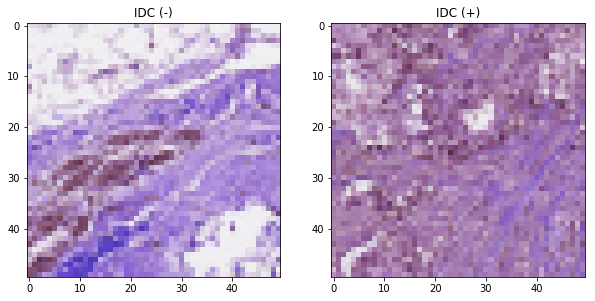

In [0]:
def plotOne(a,b):
    """
    Plot one numpy array
    """
    plt.subplot(1,2,1)
    plt.title('IDC (-)')
    plt.imshow(a[0])
    plt.subplot(1,2,2)
    plt.title('IDC (+)')
    plt.imshow(b[0])
plotOne(imgs0, imgs1) 

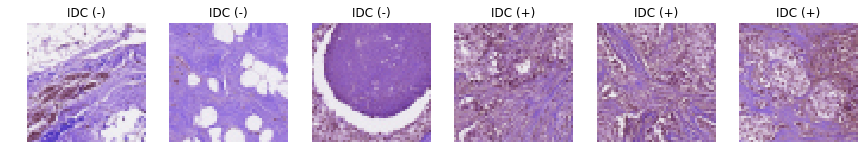

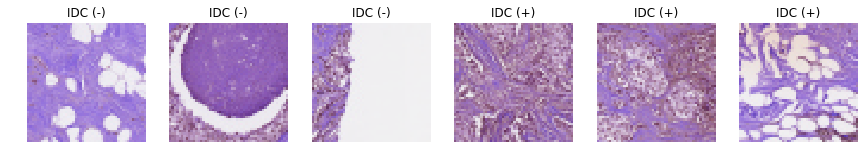

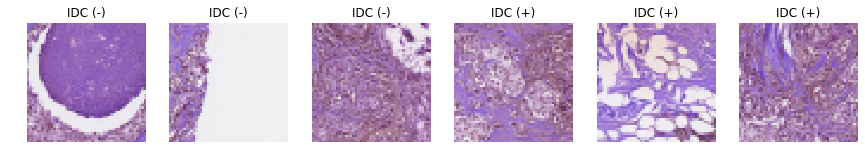

In [0]:
def plotTwo(a,b): 
    """
    Plot a bunch of numpy arrays sorted by label
    """
    for row in range(3):
        plt.figure(figsize=(20, 10))
        for col in range(3):
            plt.subplot(1,8,col+1)
            plt.title('IDC (-)')
            plt.imshow(a[0+row+col])
            plt.axis('off')       
            plt.subplot(1,8,col+4)
            plt.title('IDC (+)')
            plt.imshow(b[0+row+col])
            plt.axis('off')
plotTwo(imgs0, imgs1) 

In [0]:
X=np.array(X)
X=X/255.0

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2)

# Reduce Sample Size for DeBugging
X_train = X_train[0:300000] 
Y_train = Y_train[0:300000]
X_test = X_test[0:300000] 
Y_test = Y_test[0:300000]

print("Training Data Shape:", X_train.shape)
print("Testing Data Shape:", X_test.shape)

Training Data Shape: (48000, 50, 50, 3)
Testing Data Shape: (12000, 50, 50, 3)


In [0]:
# Encode labels to hot vectors (ex : 2 -> [0,0,1,0,0,0,0,0,0,0])
Y_trainHot = to_categorical(Y_train, num_classes = 2)
Y_testHot = to_categorical(Y_test, num_classes = 2)

{0: 'IDC(-)', 1: 'IDC(+)'}


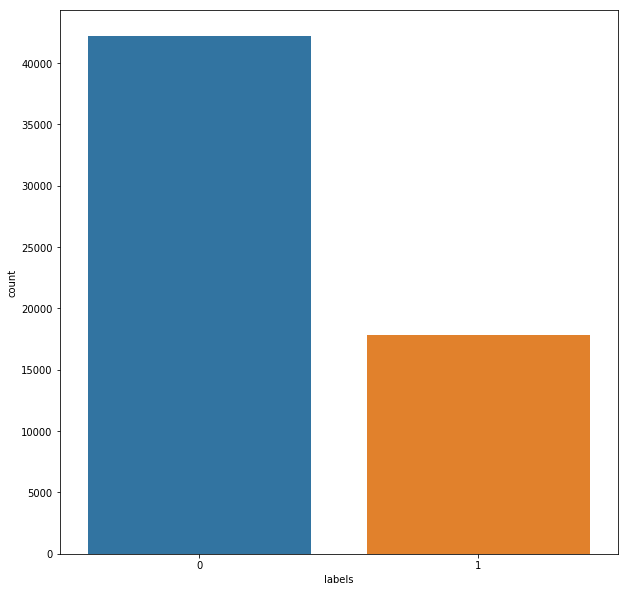

In [0]:
lab = df['labels']
dist = lab.value_counts()
sns.countplot(lab)
print(dict_characters)

{0: 'IDC(-)', 1: 'IDC(+)'}


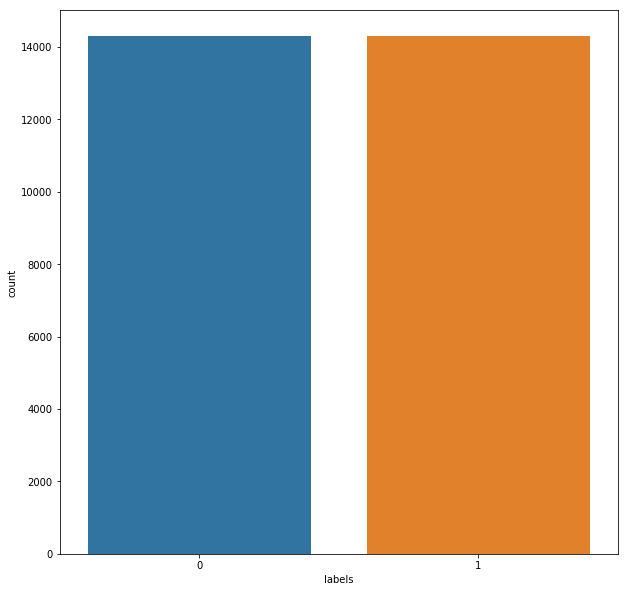

In [0]:
# Deal with imbalanced class sizes below
# Make Data 1D for compatability upsampling methods
X_trainShape = X_train.shape[1]*X_train.shape[2]*X_train.shape[3]
X_testShape = X_test.shape[1]*X_test.shape[2]*X_test.shape[3]
X_trainFlat = X_train.reshape(X_train.shape[0], X_trainShape)
X_testFlat = X_test.reshape(X_test.shape[0], X_testShape)
#print("X_train Shape: ",X_train.shape)
#print("X_test Shape: ",X_test.shape)
#print("X_trainFlat Shape: ",X_trainFlat.shape)
#print("X_testFlat Shape: ",X_testFlat.shape)

from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler
#ros = RandomOverSampler(ratio='auto')
ros = RandomUnderSampler(ratio='auto')
X_trainRos, Y_trainRos = ros.fit_sample(X_trainFlat, Y_train)
X_testRos, Y_testRos = ros.fit_sample(X_testFlat, Y_test)

# Encode labels to hot vectors (ex : 2 -> [0,0,1,0,0,0,0,0,0,0])
Y_trainRosHot = to_categorical(Y_trainRos, num_classes = 2)
Y_testRosHot = to_categorical(Y_testRos, num_classes = 2)
#print("X_train: ", X_train.shape)
#print("X_trainFlat: ", X_trainFlat.shape)
#print("X_trainRos Shape: ",X_trainRos.shape)
#print("X_testRos Shape: ",X_testRos.shape)
#print("Y_trainRosHot Shape: ",Y_trainRosHot.shape)
#print("Y_testRosHot Shape: ",Y_testRosHot.shape)

for i in range(len(X_trainRos)):
    height, width, channels = 50,50,3
    X_trainRosReshaped = X_trainRos.reshape(len(X_trainRos),height,width,channels)
#print("X_trainRos Shape: ",X_trainRos.shape)
#print("X_trainRosReshaped Shape: ",X_trainRosReshaped.shape)

for i in range(len(X_testRos)):
    height, width, channels = 50,50,3
    X_testRosReshaped = X_testRos.reshape(len(X_testRos),height,width,channels)
#print("X_testRos Shape: ",X_testRos.shape)
#print("X_testRosReshaped Shape: ",X_testRosReshaped.shape)

dfRos = pd.DataFrame()
dfRos["labels"]=Y_trainRos
labRos = dfRos['labels']
distRos = lab.value_counts()
sns.countplot(labRos)
print(dict_characters)

In [0]:
from sklearn.utils import class_weight
class_weight = class_weight.compute_class_weight('balanced', np.unique(Y_train), Y_train)
print("Old Class Weights: ",class_weight)
from sklearn.utils import class_weight
class_weight2 = class_weight.compute_class_weight('balanced', np.unique(Y_trainRos), Y_trainRos)
print("New Class Weights: ",class_weight2)

Old Class Weights:  [0.71208165 1.67879127]
New Class Weights:  [1. 1.]


In [0]:
# Helper Functions  Learning Curves and Confusion Matrix

class MetricsCheckpoint(Callback):
    """Callback that saves metrics after each epoch"""
    def __init__(self, savepath):
        super(MetricsCheckpoint, self).__init__()
        self.savepath = savepath
        self.history = {}
    def on_epoch_end(self, epoch, logs=None):
        for k, v in logs.items():
            self.history.setdefault(k, []).append(v)
        np.save(self.savepath, self.history)

def plotKerasLearningCurve():
    plt.figure(figsize=(10,5))
    metrics = np.load('logs.npy')[()]
    filt = ['acc'] # try to add 'loss' to see the loss learning curve
    for k in filter(lambda x : np.any([kk in x for kk in filt]), metrics.keys()):
        l = np.array(metrics[k])
        plt.plot(l, c= 'r' if 'val' not in k else 'b', label='val' if 'val' in k else 'train')
        x = np.argmin(l) if 'loss' in k else np.argmax(l)
        y = l[x]
        plt.scatter(x,y, lw=0, alpha=0.25, s=100, c='r' if 'val' not in k else 'b')
        plt.text(x, y, '{} = {:.4f}'.format(x,y), size='15', color= 'r' if 'val' not in k else 'b')   
    plt.legend(loc=4)
    plt.axis([0, None, None, None]);
    plt.grid()
    plt.xlabel('Number of epochs')

def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.figure(figsize = (5,5))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=90)
    plt.yticks(tick_marks, classes)
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")
    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

def plot_learning_curve(history):
    plt.figure(figsize=(8,8))
    plt.subplot(1,2,1)
    plt.plot(history.history['acc'])
    plt.plot(history.history['val_acc'])
    plt.title('model accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.savefig('./accuracy_curve.png')
    #plt.clf()
    # summarize history for loss
    plt.subplot(1,2,2)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.savefig('./loss_curve.png')

In [0]:
def runKerasCNNAugment(a,b,c,d,e,f):
    """
    Run Keras CNN: https://github.com/fchollet/keras/blob/master/examples/mnist_cnn.py
    """
    batch_size = 128
    num_classes = 2
    epochs = 8
#     img_rows, img_cols = a.shape[1],a.shape[2]
    img_rows,img_cols=50,50
    input_shape = (img_rows, img_cols, 3)
    model = Sequential()
    model.add(Conv2D(32, kernel_size=(3, 3),
                     activation='relu',
                     input_shape=input_shape,strides=e))
    model.add(Conv2D(64, (3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Dropout(0.25))
    model.add(Flatten())
    model.add(Dense(128, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(num_classes, activation='softmax'))
    model.compile(loss=keras.losses.categorical_crossentropy,
                  optimizer=keras.optimizers.Adadelta(),
                  metrics=['accuracy'])
    datagen = ImageDataGenerator(
        featurewise_center=False,  # set input mean to 0 over the dataset
        samplewise_center=False,  # set each sample mean to 0
        featurewise_std_normalization=False,  # divide inputs by std of the dataset
        samplewise_std_normalization=False,  # divide each input by its std
        zca_whitening=False,  # apply ZCA whitening
        rotation_range=20,  # randomly rotate images in the range (degrees, 0 to 180)
        width_shift_range=0.2,  # randomly shift images horizontally (fraction of total width)
        height_shift_range=0.2,  # randomly shift images vertically (fraction of total height)
        horizontal_flip=True,  # randomly flip images
        vertical_flip=True)  # randomly flip images
    history = model.fit_generator(datagen.flow(a,b, batch_size=32),
                        steps_per_epoch=len(a) / 32, epochs=epochs,class_weight=f, validation_data = [c, d],callbacks = [MetricsCheckpoint('logs')])
    score = model.evaluate(c,d, verbose=0)
    print('\nKeras CNN #1C - accuracy:', score[1],'\n')
    y_pred = model.predict(c)
    map_characters = {0: 'IDC(-)', 1: 'IDC(+)'}
    print('\n', sklearn.metrics.classification_report(np.where(d > 0)[1], np.argmax(y_pred, axis=1), target_names=list(map_characters.values())), sep='')    
    Y_pred_classes = np.argmax(y_pred,axis=1) 
    Y_true = np.argmax(d,axis=1) 
    plotKerasLearningCurve()
    plt.show()  
    plot_learning_curve(history)
    plt.show()
    confusion_mtx = confusion_matrix(Y_true, Y_pred_classes) 
    plot_confusion_matrix(confusion_mtx, classes = list(dict_characters.values())) 
    plt.show()
runKerasCNNAugment(X_trainRosReshaped, Y_trainRosHot, X_testRosReshaped, Y_testRosHot,2,class_weight2)

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
Instructions for updating:
Use tf.cast instead.
Epoch 1/8
894/893 [==============================] - 109s 122ms/step - loss: 0.5685 - acc: 0.7152 - val_loss: 0.4853 - val_acc: 0.7824
Epoch 2/8
894/893 [==============================] - 107s 120ms/step - loss: 0.4658 - acc: 0.7939 - val_loss: 0.4163 - val_acc: 0.8131
Epoch 3/8
894/893 [==============================] - 110s 123ms/step - loss: 0.4390 - acc: 0.8084 - val_loss: 0.5651 - val_acc: 0.7326
Epoch 4/8
894/893 [==============================] - 104s 117ms/step - loss: 0.4211 - acc: 0.8169 - val_loss: 0.4908 - val_acc: 0.7940
Epoch 5/8
894/893 [==============================] - 108s 121ms/step - loss: 0.4128 - acc: 0.8219 - val_loss: 0.4068 - val_acc: 0.8300
Epoch 6/8
894/893 [==============================] - 107s 120ms/step - loss: 0.4033 - acc:

ValueError: ignored

<Figure size 720x360 with 0 Axes>